In [ ]:
""" Extract keypoint peaks from image (first we need to extract keypoints, then assign labels to them)
"""

# Setup

## Imports

In [9]:
"""Normal estimation"""
ROOT_DIR = "/home/user/Documents/projects/Metaworld"

import sys
sys.path.append(ROOT_DIR)

%matplotlib widget  
import argparse
import gc
import os
import json
import random
from PIL import Image
from typing import Dict, List, Union

import cv2
import numpy as np

import gc
import matplotlib.pyplot as plt
import torch
from torchvision.transforms import PILToTensor
import torch.nn as nn
import numpy as np
import torch.nn.functional as F
from scipy.spatial.transform import Rotation as R
import importlib
from typing import List
from easydict import EasyDict as edict
from tqdm import tqdm

# visualization
import plotly.express as px
import plotly.graph_objects as go
from lightglue import viz2d
from einops import rearrange

import open3d as o3d
from open3d.web_visualizer import draw

In [10]:
from keyframes.align_ft_spair import dataset
from keyframes.align_ft_spair.utils import geo_utils, spair_utils, ft_align_utils, depth_match_utils, geom_utils, img_utils, kpt_likelihood_utils, kpt_likelihood_opt_v2, focal_opt_utils, peak_extraction_utils
from keyframes.align_ft_spair import pl_modules
from keyframes.align_ft_spair.ext import projection_network, utils_correspondence, utils_dataset
from utils import torch_utils, plotly_utils

## Data

In [11]:
# params
spair_data_folder="/media/user/ssd2t/datasets2/SPair-71k"
embds_folder_geo="/media/user/EXTREMESSD/datasets/SPair-71k/geo"
embds_folder_sd="/media/user/EXTREMESSD/datasets/SPair-71k/DiffusionFeatures60x60"
img_files_np_path_train="/home/user/Documents/projects/diffusion-features/experiments/ft_align/aeroplane_train_files_unique.npy"
img_files_np_path_eval="/home/user/Documents/projects/diffusion-features/experiments/ft_align/aeroplane_eval_files_unique.npy"
# depth_folder = "/media/user/EXTREMESSD/datasets/SPair-71k/miragold"
depth_folder = "/media/user/EXTREMESSD/datasets/SPair-71k/DepthAnythingV2"
masks_folder = "/media/user/EXTREMESSD/datasets/SPair-71k/SegAnyMasks"
# kpt_indices=[3, 4, 5]
category="aeroplane"
img_size=960
embd_size=60
pad=True

img_files_train = np.load(img_files_np_path_train).tolist()
img_files_eval = np.load(img_files_np_path_eval).tolist()

flips_train = [False]
flips_eval = [False]

In [113]:
# load embeddings
img_embds_train, img_embds_hat_train = geo_utils.load_geo_embds(
    img_files_train,
    embds_folder_dino=embds_folder_geo,
    embds_folder_sd=embds_folder_sd,
    flips=flips_train,
)
img_embds_train = img_embds_train.detach().cpu()
img_embds_hat_train = img_embds_hat_train.detach().cpu()

# load embeddings
img_embds_eval, img_embds_hat_eval = geo_utils.load_geo_embds(
    img_files_eval,
    embds_folder_dino=embds_folder_geo,
    embds_folder_sd=embds_folder_sd,
    flips=flips_eval,
)
img_embds_eval = img_embds_eval.detach().cpu()
img_embds_hat_eval = img_embds_hat_eval.detach().cpu()

# build kpt_idx_to_kpt_embds
kpt_idx_to_kpt_embds_train, kpt_embd_coords_train, kpt_img_coords_train = spair_utils.build_kpt_idx_to_kpt_embds(
    img_files=img_files_train,
    img_embds_hat=img_embds_hat_train,
    spair_data_folder=spair_data_folder,
    img_size=img_size,
    embd_size=embd_size,
    pad=pad,
    flips=flips_train
)
kpt_idx_to_kpt_embds_eval, kpt_embd_coords_eval, kpt_img_coords_eval = spair_utils.build_kpt_idx_to_kpt_embds(
    img_files=img_files_eval,
    img_embds_hat=img_embds_hat_eval,
    spair_data_folder=spair_data_folder,
    img_size=img_size,
    embd_size=embd_size,
    pad=pad,
    flips=flips_eval
)

# average keypoint embeddings
kpt_features_avg_train = []
kpt_features_attn_avg_train = []
kpt_features_attn_sd_train = []
for kpt_idx in range(30):
    kpt_features = kpt_idx_to_kpt_embds_train[kpt_idx]
    # kpt_features is only None if keypoint label does not exist for object category
    if kpt_features is None:
        break

    if kpt_idx > 3 and kpt_idx < 22:
        kpt_idx_2 = kpt_idx + 1 if kpt_idx % 2 == 0 else kpt_idx - 1
        kpt_features_2 = kpt_idx_to_kpt_embds_train[kpt_idx_2]
        assert kpt_features_2 is not None, f"kpt_features is None for kpt_idx={kpt_idx_2}"
        kpt_features = torch.cat([kpt_features, kpt_features_2], dim=0)

    kpt_features_avg = torch.mean(kpt_features, dim=0, keepdim=True)  # (1, C)
    # compute dot product between kpt_features and kpt_features_avg
    kpt_features_attn = torch.bmm(kpt_features.unsqueeze(0), kpt_features_avg.unsqueeze(2)).squeeze(0)
    kpt_features_attn_avg = torch.mean(kpt_features_attn, dim=0, keepdim=True)
    kpt_features_attn_sd = torch.std(kpt_features_attn, dim=0, keepdim=True)
    kpt_features_avg_train.append(kpt_features_avg)
    kpt_features_attn_avg_train.append(kpt_features_attn_avg)
    kpt_features_attn_sd_train.append(kpt_features_attn_sd)

kpt_features_avg_train = torch.cat(kpt_features_avg_train, dim=0)
kpt_features_attn_avg_train = torch.cat(kpt_features_attn_avg_train, dim=0)
kpt_features_attn_sd_train = torch.cat(kpt_features_attn_sd_train, dim=0)
# print(kpt_features_avg_train.shape)

# 1.1) load depth
depths_train = []
for img_file in img_files_train:
    fn = os.path.basename(img_file).split(".")[0]
    # depth_file = f"{depth_folder}/{category}/depth_npy/{fn}_pred.npy"
    depth_file = f"{depth_folder}/{category}/{fn}_depth.npy"
    depth = np.load(depth_file)
    # NEW for depth any: normalize and adjust z
    depth = 1 - 0.3*(depth/np.max(depth))

    # NOTE instead of downsizing depth we will resize and upscale attentions
    depths_train.append(depth)

depths_eval = []
for img_file in img_files_eval:
    fn = os.path.basename(img_file).split(".")[0]
    # depth_file = f"{depth_folder}/{category}/depth_npy/{fn}_pred.npy"
    depth_file = f"{depth_folder}/{category}/{fn}_depth.npy"
    depth = np.load(depth_file)
    # NEW for depth any: normalize and adjust z
    depth = 1 - 0.3*(depth/np.max(depth))
    depths_eval.append(depth)

# 1.3) reproject to point clouds
xyz_train = []
for depth in depths_train:
    v0 = geom_utils.reproject_depth(depth)
    xyz_train.append(v0)

xyz_eval = []
for depth in depths_eval:
    v0 = geom_utils.reproject_depth(depth)
    xyz_eval.append(v0)

# TODO save xyz

# px.imshow(depths_padded_resized_train[20])


# load segmentation masks
seg_masks_train = []
seg_auto_masks_train = []
for img_file in img_files_train:
    fn = os.path.basename(img_file).split(".")[0]
    seg_mask_file = f"{masks_folder}/{category}/{fn}_masks.npy"
    seg_mask = np.load(seg_mask_file)
    seg_masks_train.append(seg_mask)

    seg_auto_mask_file = f"{masks_folder}/{category}/{fn}_auto_masks_seg.npy"
    seg_auto_mask = np.load(seg_auto_mask_file)
    seg_auto_masks_train.append(seg_auto_mask)

# Method

## Extract points for kpt img coords

Goal: Make sure that points do lie within airplane and not on edge.

In [164]:
def erode_mask(mask: np.ndarray, kernel_size=2, iterations=2):
    # Define the kernel
    kernel = np.ones((kernel_size, kernel_size), np.uint8)

    # Apply erosion
    eroded_mask = np.array(cv2.erode(mask.astype(np.uint8)*255, kernel, iterations=iterations)).astype(bool)
    return eroded_mask

def correct_keypoint_coords(img_seg_mask: np.ndarray, kpt_coords_np: np.ndarray):
    """For each point in kpt_coords, check if it is in the segmentation mask. If not, find the closest point in the mask and replace the point with it."""
    # edges = peak_extraction_utils.detect_and_thicken_edges((depth*255).astype(np.uint8), canny_threshold1=5, canny_threshold2=10, dilation_kernel_size=2)
    # mask = np.logical_and(img_seg_mask > 0, edges == 0)
    mask = erode_mask(img_seg_mask)
    mask_indices = np.argwhere(mask)
    # permute x and y
    mask_indices = mask_indices[:, [1, 0]]

    # Calculate distances using broadcasting
    distances = np.sqrt(((mask_indices[:,None,:] - kpt_coords_np[None,:,:]) ** 2).sum(axis=2))  # shape (num_mask_points, num_keypoints)

    # Find the index of the closest point in the mask for each keypoint
    closest_indices = np.argmin(distances, axis=0)
    kpt_coords_corrected = mask_indices[closest_indices]

    return kpt_coords_corrected, mask

In [167]:
i = 0

In [171]:
i += 1
print(i)

2


In [172]:
# 1) Plot image with keypoint coordinates
img_idx = i
# i += 1
img = np.array(Image.open(img_files_train[img_idx]))
# make image transparent => add alpha channel
img = np.concatenate([0.1*img, np.ones((img.shape[0], img.shape[1], 1), dtype=np.uint8)*120], axis=2)
kpt_coords = kpt_img_coords_train[img_idx].numpy()
img[kpt_coords[:, 1], kpt_coords[:, 0]] = [255, 0, 0, 255]
# px.imshow(img)
kpts_corrected, mask = correct_keypoint_coords(depths_train[img_idx], seg_masks_train[img_idx][2], torch_utils.to_np_array(kpt_img_coords_train[img_idx][:,:2]))
corrected_points_mask = np.linalg.norm(kpts_corrected - kpt_coords[:,:2], axis=1) > 0
print(kpts_corrected[corrected_points_mask] - kpt_coords[corrected_points_mask][:,:2])
print(kpt_coords[:,2][corrected_points_mask])
# px.imshow(mask)

img_xyz = geom_utils.reproject_depth(depths_train[img_idx], focal_length=5)
img_xyz_flat = img_xyz.reshape((-1,3))
kpts_xyz = img_xyz[kpts_corrected[:, 1], kpts_corrected[:, 0]]
kpt_labels = kpt_img_coords_train[img_idx][:,2].numpy()

scatter = go.Scatter3d(
    x=kpts_xyz[:,0],
    y=kpts_xyz[:,1],
    z=kpts_xyz[:,2],
    mode='markers',
    marker=dict(
        size=6,
        color=px.colors.qualitative.Alphabet,
        # color=z,  # set color to an array/list of desired values
        # colorscale='Viridis',  # choose a colorscale
        opacity=0.8
    ),
    hovertext=[f"{i}" for i in kpt_labels]
)

scatter2 = go.Scatter3d(
    x=img_xyz_flat[:,0],
    y=img_xyz_flat[:,1],
    z=img_xyz_flat[:,2],
    mode='markers',
    marker=dict(
        size=1,
        color="black",
        # color=z,  # set color to an array/list of desired values
        # colorscale='Viridis',  # choose a colorscale
        opacity=0.8
    ),
    # hovertext=[f"{i}" for i in kpt_labels]
)

fig = go.FigureWidget(data=[scatter2, scatter]) # scatter_img_xyz_orig
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0), scene_aspectmode='data')
fig.show()

[[0 1]]
[22]


In [119]:
kpt_coords

array([[ 11, 174,   0],
       [ 25, 158,   1],
       [ 47, 147,   2],
       [ 71, 205,   3],
       [208, 188,   7],
       [486, 135,   9],
       [248, 186,  11],
       [178, 172,  13],
       [447, 135,  17],
       [377, 143,  19],
       [348, 134,  22],
       [403,  73,  23]])

In [166]:
px.imshow(mask)

In [84]:
px.imshow(img)

## Using Segmentation Masks

Note, the problem is that only unique objects such as wheels or engines can be segmented. This aproach falls short when extracting areas of single points *within* the airplane such as wing foot end/start.

In [ ]:
# 1) Perform k-means clustering on each image with k=2
# 2) Over images, compute the mean & SD of the distance between the two clusters (only where we have ground truth data)
# 3) Merge clusters that are too close to each other

In [146]:
from keyframes.align_ft_spair.utils import peak_extraction_utils

img_xyz_orig = xyz_train
kpt_img_coords = kpt_img_coords_train
kpt_features_avg = kpt_features_avg_train
kpt_features_attn_avg = kpt_features_attn_avg_train
kpt_features_attn_sd = kpt_features_attn_sd_train
img_embds_hat = img_embds_hat_train

i = 0

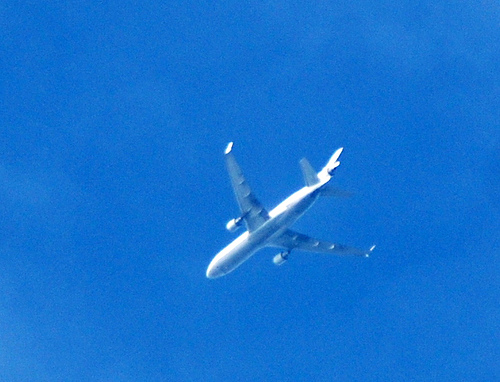

In [164]:
# img_idx = 0 and 2 seem good testing candidates
img_idx = i
i += 1
Image.open(img_files_train[img_idx])

In [15]:
importlib.reload(peak_extraction_utils)

<module 'keyframes.align_ft_spair.utils.peak_extraction_utils' from '/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/utils/peak_extraction_utils.py'>

In [165]:
img_xyz_orig_torch_i = torch_utils.to_torch_tensor(
    img_xyz_orig[img_idx], device="cpu"
)
h_orig, w_orig = img_xyz_orig_torch_i.shape[:2]
query_xy = kpt_img_coords[img_idx][:, 0:2]
query_kpt_labels = kpt_img_coords[img_idx][:, 2].int()
img_kpt_label_likelihood = kpt_likelihood_utils.compute_kpt_label_likelihood(
    img_embd_hat=img_embds_hat[img_idx],
    kpt_embd_hat_mean=kpt_features_avg,
    kpt_attn_mean=kpt_features_attn_avg[:, 0],
    kpt_attn_sd=kpt_features_attn_sd[:, 0],
)

depth_img = (img_xyz_orig_torch_i[:,:,2]*255).numpy().astype(np.uint8)
img_np = np.array(Image.open(img_files_train[img_idx])).astype(np.uint8)
img_torch = torch.from_numpy(img_np).double()

thick_edges = peak_extraction_utils.detect_and_thicken_edges(img_np, canny_threshold1=50, canny_threshold2=300, dilation_kernel_size=2)

# kpt_attn = ft_align_utils.compute_attn(
#     kpt_features_avg,
#     img_embds_hat[img_idx][None,:,:,:],
#     enable_normalize=False,
#     enable_softmax=False
# )

In [170]:
kpt_idx = 6
attn = img_utils.inv_pad_resize_img(img_kpt_label_likelihood[kpt_idx], h_orig, w_orig)
# attn_0 = img_utils.inv_pad_resize_img(kpt_attn[kpt_idx], h_orig, w_orig)

# kpt_indices = torch.arange(img_kpt_label_likelihood.shape[0])
# ignore_kpt_indices = kpt_indices[~kpt_indices.eq(kpt_idx+1)]
# kpt_likelihood_ratio = img_kpt_label_likelihood[kpt_idx] / torch.sum(img_kpt_label_likelihood, dim=0)
# kpt_likelihood_ratio_up = img_utils.inv_pad_resize_img(kpt_likelihood_ratio, h_orig, w_orig)

# ambiguity = img_kpt_label_likelihood / torch.sum(img_kpt_label_likelihood, dim=0, keepdim=True)
# ambiguity_kpt_up = img_utils.inv_pad_resize_img(ambiguity[kpt_idx], h_orig, w_orig)

# point_mask = attn > 0.6 * attn.max()

# point_mask = torch.logical_and(attn > 0.2 * attn.max(), torch.from_numpy(thick_edges) == 0)
# point_mask = torch.logical_and(point_mask, torch.from_numpy(seg_masks_train[img_idx][2]) > 0)

point_mask = torch.logical_and(attn > 0.2 * attn.max(), torch.from_numpy(seg_masks_train[img_idx][2]) > 0)

# point_mask = torch.logical_and(point_mask, ambiguity_kpt_up > 0.4*ambiguity_kpt_up.max())

px.imshow(torch.mean(img_torch, dim=-1)/255 + point_mask)

In [93]:
# 1) find islands in point_mask
# 2) for each island select masks in generated masks that align with point_mask


In [171]:
# 1) find islands in point_mask
from keyframes import seg_any
islands, island_ids = seg_any.find_all_islands_in_mask(point_mask.numpy())

In [172]:
# 2) for each island select masks in generated masks that align with point_mask
def compute_mask_overlap(mask1, mask2):
    intersection = np.logical_and(mask1 > 0, mask2 > 0)
    area1 = np.sum(mask1)
    area2 = np.sum(mask2)
    area_intersection = np.sum(intersection)
    # print(area1, area2, area_intersection)
    return area_intersection / area1, area_intersection / area2

auto_masks = seg_auto_masks_train[img_idx]


In [173]:
island_overlaps = []
for island_id in island_ids:
    overlaps = []
    for m in range(auto_masks.shape[0]):
        mask = auto_masks[m]
        overlap1, overlap2 = compute_mask_overlap(mask, islands == island_id)
        overlaps.append([overlap1, overlap2])
    island_overlaps.append(overlaps)
island_overlaps_arr = torch.tensor(island_overlaps)

In [182]:
island_ids

array([0, 1, 2])

In [183]:
# TODO join islands if they improve the metric
island_id = 2
sort_res = torch.sort(torch.min(island_overlaps_arr[island_id],dim=1).values, descending=True)
sort_res

torch.return_types.sort(
values=tensor([0.7849, 0.0222, 0.0018, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000], dtype=torch.float64),
indices=tensor([6, 1, 4, 0, 2, 3, 5, 7, 8, 9]))

In [184]:
px.imshow(torch.mean(img_torch, dim=-1)/255 + auto_masks[sort_res.indices[0]])